In [30]:
import numpy as np

In [31]:
class Perceptron:
    def __init__(self, n, th=0.5, lr=0.1):
        self.w = np.random.rand(n)
        self.th = th
        self.lr = lr
    
    def compute(self, x):
        if np.dot(np.array(x), self.w) > self.th:
            return 1
        return 0
    
    def train(self, training):
        """
        Training array is a set of vectors, where the last element is the
        correct answer.
        """
        for t in training:
            y = self.compute(np.array(t[0:-1]))
            for i in range(len(self.w)):
                self.w[i] += self.lr * (t[-1]-y)*t[i]

Let's teach the perceptron to be an and gate!
0 0 => 0
0 1 => 0
1 0 => 0
1 1 => 1

In [32]:
# make a two input perceptron
ap = Perceptron(2)

In [33]:
aptrain = [[0,0,0],
           [0,1,0],
           [1,0,0],
           [1,1,1]]
def perceptron_test(p, training):
    error = 0
    for t in training:
        y = p.compute(t[0:-1])
        print("{} -> {}".format(t, y))
        error += abs(t[-1]-y)
    return error / len(training)

perceptron_test(ap, aptrain)
ap.train(aptrain)
perceptron_test(ap, aptrain)

[0, 0, 0] -> 0
[0, 1, 0] -> 1
[1, 0, 0] -> 0
[1, 1, 1] -> 1
[0, 0, 0] -> 0
[0, 1, 0] -> 0
[1, 0, 0] -> 0
[1, 1, 1] -> 1


0.0

In [34]:
ap.train(aptrain)
perceptron_test(ap, aptrain)

[0, 0, 0] -> 0
[0, 1, 0] -> 0
[1, 0, 0] -> 0
[1, 1, 1] -> 1


0.0

In [35]:
# train an or gate
orp = Perceptron(2)
ortrain=[[0,0,0],
         [0,1,1],
         [1,0,1],
         [1,1,1]]
perceptron_test(orp, ortrain)

[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 1] -> 0


0.75

In [36]:
orp.train(ortrain)
perceptron_test(orp, ortrain)

[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 1] -> 1


0.5

In [42]:
from matplotlib import pyplot as plt
def learn(p, train, max_epoch=100):
    """
    Train the perceptron until the error goes to zero, or we reach max_epoch.
    Return a list of errors.
    """
    result = []
    for i in range(max_epoch):
        error = perceptron_test(p, train)
        result.append(error)
        if error == 0:
            break
        p.train(train)

    plt.plot(result)
    return result



[0, 0, 0] -> 0
[0, 1, 1] -> 1
[1, 0, 1] -> 1
[1, 1, 1] -> 1


[0.0]

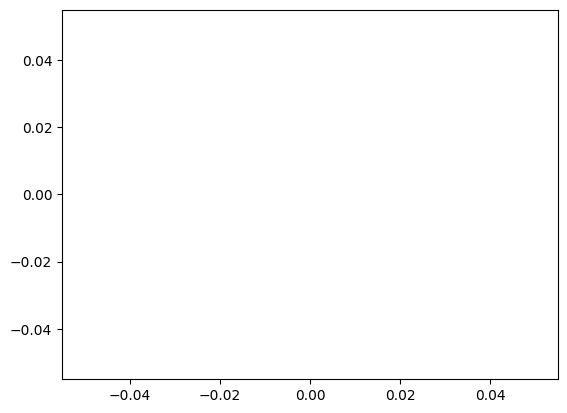

In [43]:
# learn our or function
learn(orp, ortrain)

[0, 0, 0, 0, 0] -> 0
[0, 0, 0, 1, 0] -> 1
[0, 0, 1, 0, 0] -> 0
[0, 0, 1, 1, 1] -> 1
[0, 1, 0, 0, 0] -> 1
[0, 1, 0, 1, 1] -> 1
[0, 1, 1, 0, 1] -> 1
[0, 1, 1, 1, 1] -> 1
[1, 0, 0, 0, 1] -> 0
[1, 0, 0, 1, 1] -> 1
[1, 0, 1, 0, 0] -> 0
[1, 0, 1, 1, 0] -> 1
[0, 0, 0, 0, 0] -> 0
[0, 0, 0, 1, 0] -> 1
[0, 0, 1, 0, 0] -> 0
[0, 0, 1, 1, 1] -> 1
[0, 1, 0, 0, 0] -> 1
[0, 1, 0, 1, 1] -> 1
[0, 1, 1, 0, 1] -> 0
[0, 1, 1, 1, 1] -> 1
[1, 0, 0, 0, 1] -> 0
[1, 0, 0, 1, 1] -> 1
[1, 0, 1, 0, 0] -> 0
[1, 0, 1, 1, 0] -> 1
[0, 0, 0, 0, 0] -> 0
[0, 0, 0, 1, 0] -> 1
[0, 0, 1, 0, 0] -> 0
[0, 0, 1, 1, 1] -> 1
[0, 1, 0, 0, 0] -> 1
[0, 1, 0, 1, 1] -> 1
[0, 1, 1, 0, 1] -> 1
[0, 1, 1, 1, 1] -> 1
[1, 0, 0, 0, 1] -> 0
[1, 0, 0, 1, 1] -> 1
[1, 0, 1, 0, 0] -> 0
[1, 0, 1, 1, 0] -> 1
[0, 0, 0, 0, 0] -> 0
[0, 0, 0, 1, 0] -> 1
[0, 0, 1, 0, 0] -> 0
[0, 0, 1, 1, 1] -> 0
[0, 1, 0, 0, 0] -> 1
[0, 1, 0, 1, 1] -> 1
[0, 1, 1, 0, 1] -> 0
[0, 1, 1, 1, 1] -> 1
[1, 0, 0, 0, 1] -> 0
[1, 0, 0, 1, 1] -> 1
[1, 0, 1, 0, 0] -> 0
[1, 0, 1, 1, 

[0.3333333333333333,
 0.4166666666666667,
 0.3333333333333333,
 0.5,
 0.4166666666666667,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333333333333333,
 0.3333

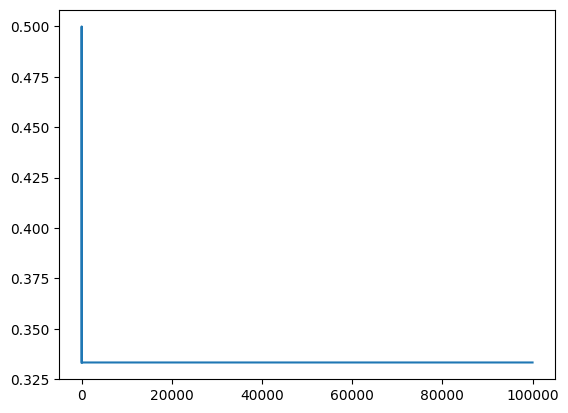

In [46]:
# learn how to be a logic unit
# s0 s1 x y 
# 00 -> and
# 01 -> or
# 10 -> not on x
lutrain = [[0,0,0,0,0],
           [0,0,0,1,0],
           [0,0,1,0,0],
           [0,0,1,1,1],
           [0,1,0,0,0],
           [0,1,0,1,1],
           [0,1,1,0,1],
           [0,1,1,1,1],
           [1,0,0,0,1],
           [1,0,0,1,1],
           [1,0,1,0,0],
           [1,0,1,1,0]]
lup = Perceptron(4)
learn(lup, lutrain,100000)

In [47]:
perceptron_test(lup, lutrain)

[0, 0, 0, 0, 0] -> 0
[0, 0, 0, 1, 0] -> 0
[0, 0, 1, 0, 0] -> 0
[0, 0, 1, 1, 1] -> 0
[0, 1, 0, 0, 0] -> 0
[0, 1, 0, 1, 1] -> 1
[0, 1, 1, 0, 1] -> 0
[0, 1, 1, 1, 1] -> 1
[1, 0, 0, 0, 1] -> 0
[1, 0, 0, 1, 1] -> 1
[1, 0, 1, 0, 0] -> 0
[1, 0, 1, 1, 0] -> 1


0.3333333333333333

[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] -> 0
[1, 1, 0] -> 0
[0, 0, 0] -> 0
[0, 1, 1] -> 0
[1, 0, 1] 

[0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5,
 0.5

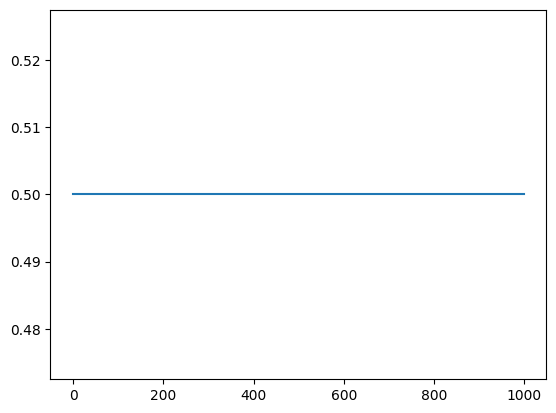

In [49]:
# learn the xor function
xortrain=[[0,0,0],
          [0,1,1],
          [1,0,1],
          [1,1,0]]
xorp = Perceptron(2)
learn(xorp, xortrain, 1000)

[0, 0, 0] -> 0
[0, 1, 0] -> 1
[1, 0, 0] -> 0
[1, 1, 1] -> 1
[0, 0, 0] -> 0
[0, 1, 0] -> 1
[1, 0, 0] -> 0
[1, 1, 1] -> 1
[0, 0, 0] -> 0
[0, 1, 0] -> 1
[1, 0, 0] -> 0
[1, 1, 1] -> 1
[0, 0, 0] -> 0
[0, 1, 0] -> 1
[1, 0, 0] -> 0
[1, 1, 1] -> 1
[0, 0, 0] -> 0
[0, 1, 0] -> 1
[1, 0, 0] -> 0
[1, 1, 1] -> 1
[0, 0, 0] -> 0
[0, 1, 0] -> 0
[1, 0, 0] -> 0
[1, 1, 1] -> 1


array([0.37550285, 0.41996104])

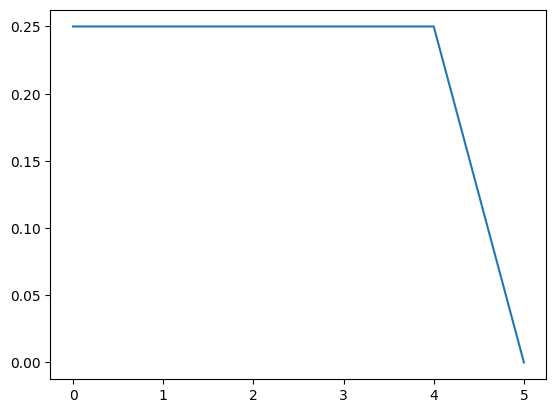

In [50]:
ap = Perceptron(2)
learn(ap, aptrain)
ap.w